In [1]:
import numpy as np
import h5py
import matplotlib.pyplot as plt
import scipy
from glob import glob
from scipy import signal
from matplotlib.ticker import FormatStrFormatter
from scipy.signal import detrend
from tqdm import tqdm
import obspy
from obspy.signal.trigger import recursive_sta_lta, plot_trigger, trigger_onset
import pickle as pkl

import copy


import pandas as pd
import rasterio
from rasterio.plot import show
from scipy.stats import gaussian_kde

from datetime import timedelta
import datetime
import numpy as np
import matplotlib.dates as mdates
from matplotlib.ticker import FuncFormatter

import pyTMD
import numpy as np
        
import pyTMD.io
import pyTMD.predict
import pyTMD.tools
import pyTMD.utilities
import timescale.time

np.float_ = np.float64
import dascore as dc

import seaborn as sns

def sintela_to_datetime(sintela_times):
    '''
    returns an array of datetime.datetime 
    ''' 
    
    days1970 = datetime.datetime.date(datetime.datetime(1970, 1, 1)).toordinal()

    # Vectorize everything
    converttime = np.vectorize(datetime.datetime.fromordinal)
    addday_lambda = lambda x : datetime.timedelta(days=x)
    adddays = np.vectorize(addday_lambda )
    
    day = days1970 + sintela_times/1e6/60/60/24
    thisDateTime = converttime(np.floor(day).astype(int))
    dayFraction = day-np.floor(day)
    thisDateTime = thisDateTime + adddays(dayFraction)

    return thisDateTime
def preprocessing_step(file):

    # Load data #
    f = h5py.File(file)
    attrs = f['Acquisition'].attrs
    data = f['Acquisition']['Raw[0]']['RawData'][:]
    this_time = f['Acquisition']['Raw[0]']['RawDataTime'][:]
    times = sintela_to_datetime(this_time)
    x = np.linspace(0,data.shape[1],data.shape[1]) * attrs['SpatialSamplingInterval']
    fs = attrs['PulseRate'] #sample rate

    if file[-9:-7] != '00':
        time_start = times[0] - datetime.timedelta(seconds=times[0].second, microseconds=times[0].microsecond)
        forward_step = np.arange(time_start, times[0], 500).shape[0]
        data_locator = np.array([int(i) for i in (this_time-this_time[0])/500]) + forward_step -1
    else:
        data_locator = np.array([int(i) for i in (this_time-this_time[0])/500])

    filled_data = np.zeros((int(fs*60),data.shape[1]))
    filled_data[:] = np.nan


    bp_top = 500
    bp_bottom = 2
    downsample_rate = int(fs/bp_top)

    #filter by freq
    sos = signal.butter(10, [bp_bottom,bp_top], 'bp', fs=fs, output='sos')
    filtered = signal.sosfiltfilt(sos, data, axis=0)

    #normalize
    normed_filtered = chan_norm(filtered)

    if data_locator[0]==0:
        filled_data[data_locator] = filtered

    else:
        first_filler = np.array([normed_filtered[0,:]]*data_locator[0])
        filled_data[:first_filler.shape[0],:] = first_filler

    mean_of_chans = np.nanmean(filled_data, axis=0)
    idx = np.where(np.isnan(filled_data))
    filled_data[idx] = np.take(mean_of_chans, idx[1])

    #FK filter
    ## rescale the times to the filled data
    if len(this_time) != int(fs*60):
        this_time = np.arange(this_time[0],int(this_time[0]+(500*fs*60)), 500)
    filled_times = sintela_to_datetime(this_time)
    new_format_times = time_fixer_4_fk(filled_times)

    dims = ('time', 'distance')
    patch = dc.Patch(data=filled_data, coords=dict(time=[np.datetime64(i) for i in new_format_times], distance=x), dims=dims)
    filt_cutoffs = np.array([500, 1500, 7000, 20000])

    fk_filtered = patch.slope_filter(filt=filt_cutoffs)
    fk_filtered_data = np.array(fk_filtered.data)

    new_attrs = dict(attrs)

    if new_attrs['MeasurementStartTime'].decode('UTF-8')[17:19] == '00' and data.shape[0] != int(new_attrs['PulseRate']*60):
        new_attrs['Status'] = 'Corrupted'
    else:
        new_attrs['Status'] = 'Good'

    ## Downsample 
    filled_times = filled_times[::downsample_rate]
    filt_filled_data = fk_filtered_data[::downsample_rate,:]

    new_attrs['PulseRate'] = new_attrs['PulseRate']/downsample_rate


    return filt_filled_data, filled_times, new_attrs


def foo(a):
    t = mdates.num2date(a)
    ms = str(t.microsecond)[:1]
    res = f"{t.hour:02}:{t.minute:02}:{t.second:02}.{ms}"
    return res

def chan_norm(das_data):
    data_normed = (das_data - np.mean(das_data, axis=0))/np.std(das_data, axis=0).T
    # data_normed_all_axis = (data_normed.T - np.mean(data_normed, axis=1))/np.std(data_normed, axis=1)   

    return data_normed

class DataStats:
    def __init__(self, data, attrs, times):
        self.sampling_rate = attrs["PulseRate"]
        self.npts = data.shape[0]
        self.starttime = times[0]
        # self.starttime.isoformat

class DAS:
    def __init__(self, id, data, attrs, times):
        self.id = id
        self.data = data
        self.stats = DataStats(data, attrs, times)


def obspy_stream_from_das(data, attrs,times):
    stats_default = {
        'network':'eastwind',
        'station':'',
        'location':'',
        'channel':'DAS',
        'starttime':times[0].strftime('%Y-%m-%dT%H:%M:%S.%fZ'),
        'endtime':times[-1].strftime('%Y-%m-%dT%H:%M:%S.%fZ'),
        'sampling_rate':attrs['PulseRate'],
        'delta':1/attrs['PulseRate'],
        'npts':0,
        'calib':1.0
    }

    streams = []
    for n,i in enumerate(data.T):
        tr = obspy.Trace(data=i,header=stats_default)
        # tr.stats.station = f'Channel {n}'
        tr.stats.npts = len(i)

        st = obspy.Stream(tr)
        streams.append(st)
    return streams

def parallel_event_finding(dummy):
    times_all,attrs,channel,all_data = dummy
    trigger_on=3.5, 
    trigger_off=1.2
    
    DAS_channel = DAS(channel, all_data, attrs, times_all)


    cft = recursive_sta_lta(DAS_channel.data, int(1 * attrs['PulseRate']), int(10 * attrs['PulseRate']))
    trigger_times = trigger_onset(cft, trigger_on, trigger_off)
    trigger_times_list = [trigger_times]     

    trigger_times_list_datetime = []

    for trigs_samp_time in trigger_times_list:
        trigger_times_list_datetime.append(times_all[trigs_samp_time])
    return {str(channel): trigger_times_list_datetime}


def time_fixer_4_fk(times):
    times_copy = times.copy()
    new_format_times = []
    for i in times_copy:
        if round(i.microsecond/500)*500 == 1000000:
            microsecond = 0
            second = i.second + 1
            minute = i.minute
            hour = i.hour
            day = i.day
            if second == 60:
                second = 0
                minute = minute+1

            if minute == 60:
                minute = 0
                hour=hour+1
            
            if hour == 24:
                hour = 0
                day = day+1
            
        else:
            microsecond = int(round(i.microsecond/500)*500)
            second = i.second
            minute = i.minute
            hour = i.hour
            day = i.day

        new_format_times.append(datetime.datetime(year=i.year,
                                                month=i.month,
                                                day=day,
                                                hour=hour,
                                                minute=minute,
                                                second=second,
                                                microsecond=microsecond))
    return new_format_times


import pathlib



import pandas as pd
from obspy import UTCDateTime
from obspy.clients.fdsn.mass_downloader import (
    GlobalDomain,
    Restrictions,
    MassDownloader,
)
from obspy.core import AttribDict
from pyproj import Proj
from multiprocessing import Pool

from quakemigrate import QuakeScan, Trigger
from quakemigrate.io import Archive, read_stations
from quakemigrate.lut import compute_traveltimes
from quakemigrate.signal.onsets import STALTAOnset
from quakemigrate.signal.pickers import GaussianPicker

import emcee
%matplotlib widget

## Load the necessary stuff

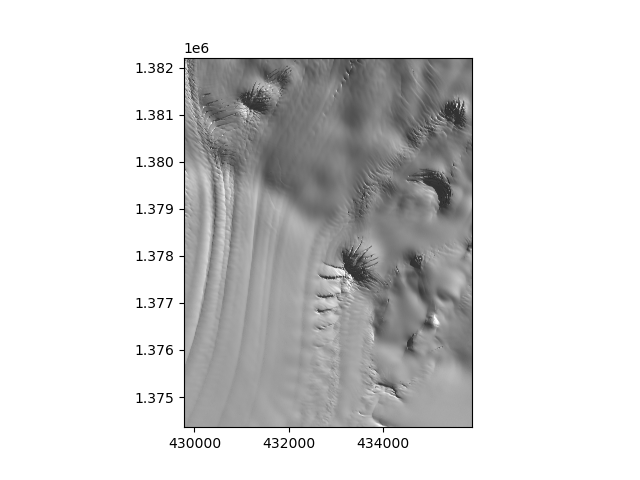

In [2]:
channel_locations = np.array(pd.read_csv('../cable_geometry/Eastwind_channel_locations.txt', sep=' ', header=None))

# Specify the path to the GeoPackage file
gpkg_path = "../imagery/eastwind_image_reproject_AOI_clip.tif"

fig,ax = plt.subplots()


# Open the GeoPackage file in read mode
with rasterio.open(gpkg_path) as src:
    # Read the image data as a NumPy array
    image_data = src.read()

    # Access metadata if needed
    metadata = src.meta

    # Process or visualize the image data
    # For example, to display the image using matplotlib:
    show(image_data, transform=src.transform, ax=ax) 
    # ax.imshow(image_data[0], cmap='gray') # Assuming single-band image, adjust as needed

## Load the picks

In [3]:
# with open('../event_locations/good_event_locations.pkl', 'rb') as f:
#     all_locations_good = pkl.load(f)

with open('../auto_picked_events/auto_picked_events.pkl', 'rb') as f:
    # Serialize and write the data to the file
    all_picks = pkl.load(f)

In [4]:
# all_event_times=[]
# for event_num in range(len(all_picks)):
#     event_datetime = datetime.datetime.fromtimestamp(np.mean(all_picks['Event '+str(event_num)][1]), tz=datetime.timezone.utc)
#     all_event_times.append(event_datetime)


## Load the file that is at the same time as the pick

In [33]:
event_num = 58

event_datetime = datetime.datetime.fromtimestamp(np.mean(all_picks['Event '+str(event_num)][1]), tz=datetime.timezone.utc)
wanted_file_str = 'Eastwind_decimator_2024-12-'+str(event_datetime.day)+'_'+event_datetime.strftime("%H")+"."+event_datetime.strftime("%M")+".00_UTC.h5"

file = '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/'+wanted_file_str

In [34]:
f = h5py.File(file)
attrs = f['Acquisition'].attrs
data = f['Acquisition']['Raw[0]']['RawData'][:]
this_time = f['Acquisition']['Raw[0]']['RawDataTime'][:]
times = sintela_to_datetime(this_time)
x = np.linspace(0,data.shape[1],data.shape[1]) * attrs['SpatialSamplingInterval']


fs = attrs['PulseRate'] #sample rate
bp_top = 200
bp_bottom = 1
downsample_rate = int(fs/bp_top)
#filter by freq
sos = signal.butter(10, [bp_bottom,bp_top], 'bp', fs=fs, output='sos')
filtered = signal.sosfiltfilt(sos, data, axis=0)
#FK filter
new_format_times = time_fixer_4_fk(times)
dims = ('time', 'distance')
patch = dc.Patch(data=filtered, coords=dict(time=[np.datetime64(i) for i in new_format_times], distance=x), dims=dims)
filt_cutoffs = np.array([0, 400, 8000,np.inf])

fk_filtered = patch.slope_filter(filt=filt_cutoffs)
fk_filtered_data = np.array(fk_filtered.data)


#normalize
data_normed_filtered = chan_norm(fk_filtered_data)


In [35]:
event_picks = [datetime.datetime.fromtimestamp(i, tz=datetime.timezone.utc) for i in all_picks['Event '+str(event_num)][1]]
event_chans = np.array(all_picks['Event '+str(event_num)][0])

# Slice at the pick time

In [36]:
times_utc = [i.replace(tzinfo=datetime.timezone.utc) for i in times]
times_utc_ts = [i.timestamp() for i in times_utc]

slice_loc = int((np.mean(all_picks['Event '+str(event_num)][1]) - times_utc_ts[0]) * fs)

In [44]:
start_event = slice_loc-(int(fs*1))
end_event = slice_loc+(int(fs*5))

picked_data = data_normed_filtered[start_event:end_event,:]
picked_times = times[start_event:end_event]


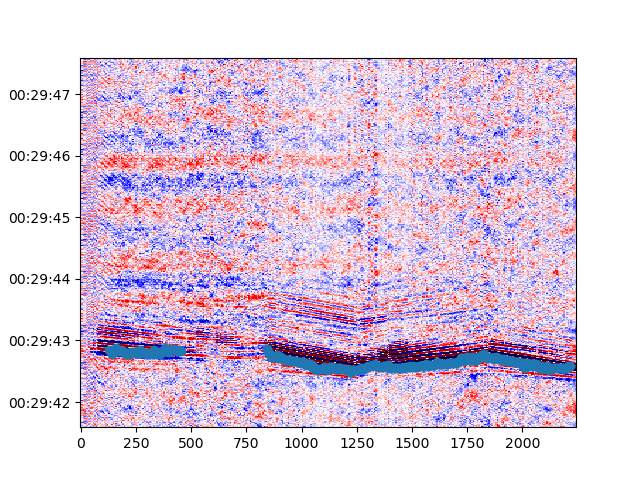

In [45]:
fig,ax = plt.subplots()

ax.pcolormesh(x,picked_times,picked_data, cmap='seismic', vmin=-5,vmax=5)
ax.scatter(event_chans*attrs['SpatialSamplingInterval'], event_picks)
plt.show()

# Plot the spectrogram on a single channel

In [46]:
f, t, Sxx = signal.spectrogram(picked_data[:,200], fs, nperseg=128,noverlap=64)

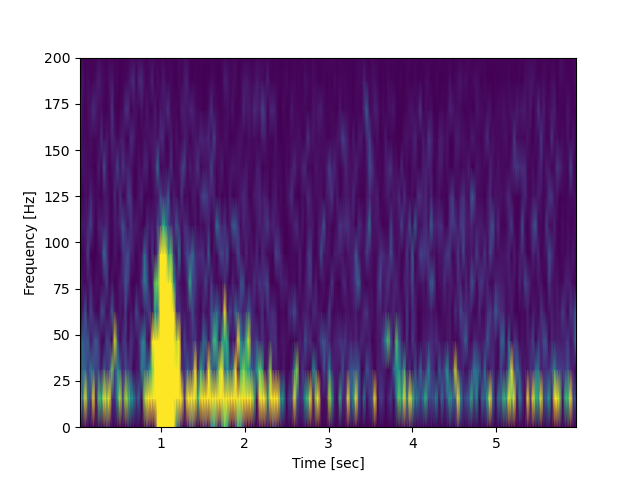

In [47]:
fig,ax = plt.subplots()

ax.pcolormesh(t, f, Sxx, shading='gouraud',vmin=0, vmax=.01)
ax.set_ylim([0,200])
ax.set_ylabel('Frequency [Hz]')
ax.set_xlabel('Time [sec]')
plt.show()

# Plot the mean spectrogram

In [41]:
times_utc = [i.replace(tzinfo=datetime.timezone.utc) for i in times]
times_utc_ts = [i.timestamp() for i in times_utc]

list_of_specs = []

for pick, chan in zip(all_picks['Event '+str(event_num)][1], all_picks['Event '+str(event_num)][0]):

    slice_loc = int((pick - times_utc_ts[0]) * fs)

    start_event = slice_loc-(int(fs*1))
    end_event = slice_loc+(int(fs*5))

    picked_data = data_normed_filtered[start_event:end_event,chan]
    picked_times = times[start_event:end_event]


    f, t, Sxx = signal.spectrogram(picked_data, fs, nperseg=256,noverlap=128)

    list_of_specs.append(Sxx)

In [31]:
mean_spec = np.mean(np.array(list_of_specs), axis=0)

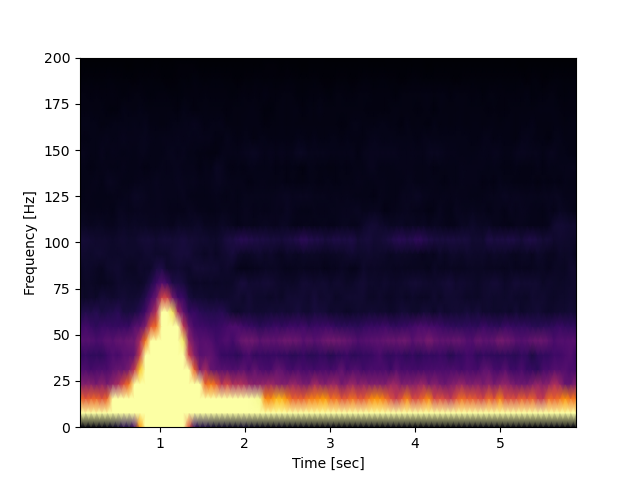

In [32]:
fig,ax = plt.subplots()

ax.pcolormesh(t, f, mean_spec, shading='gouraud',vmin=0,vmax=0.005, cmap='inferno')
ax.set_ylabel('Frequency [Hz]')
ax.set_xlabel('Time [sec]')
ax.set_ylim([0,200])
plt.show()

# Save all spectrograms

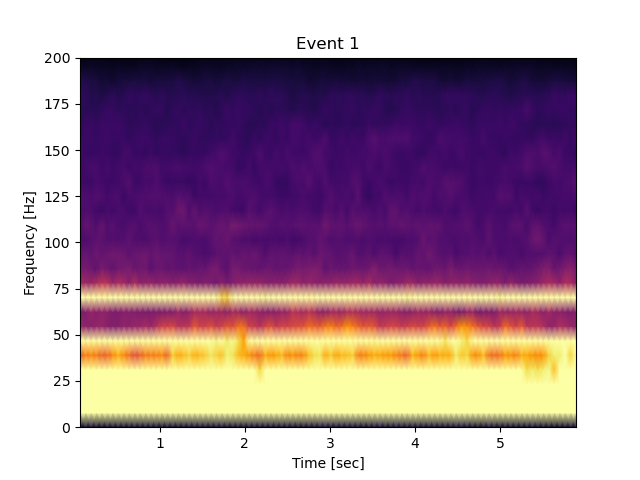

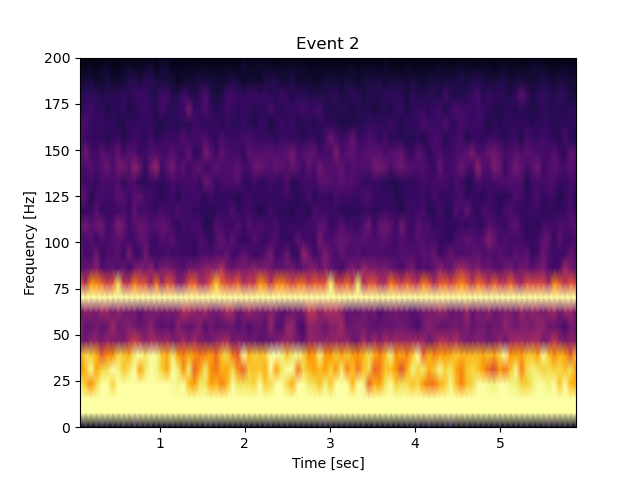

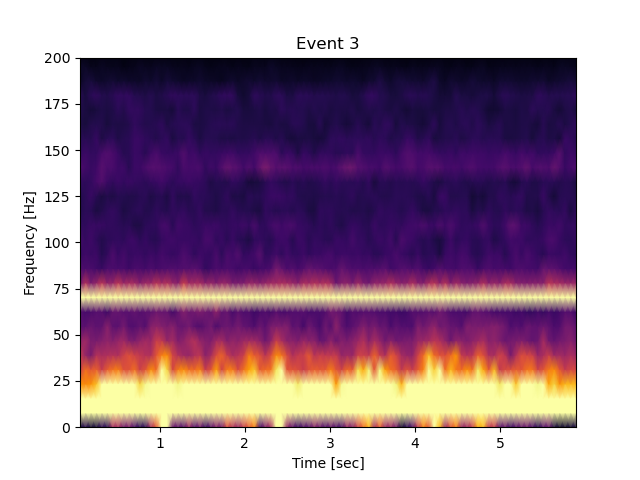

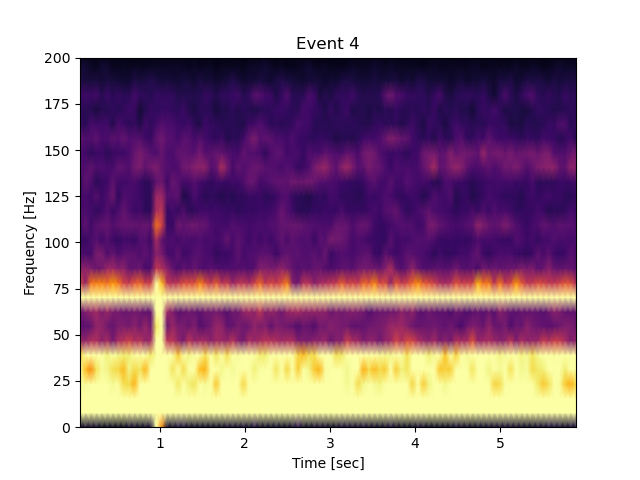

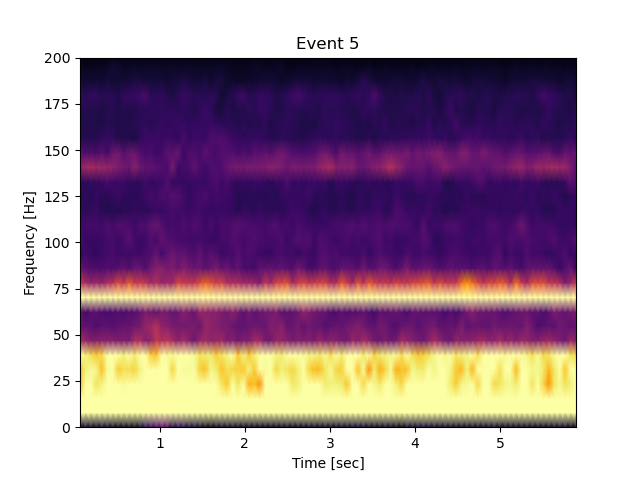

...

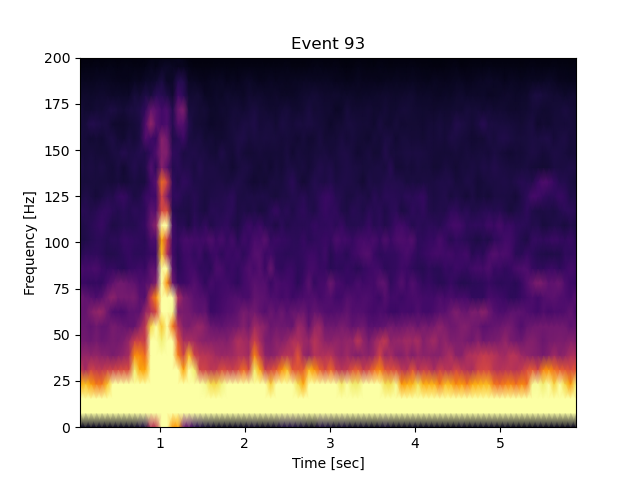

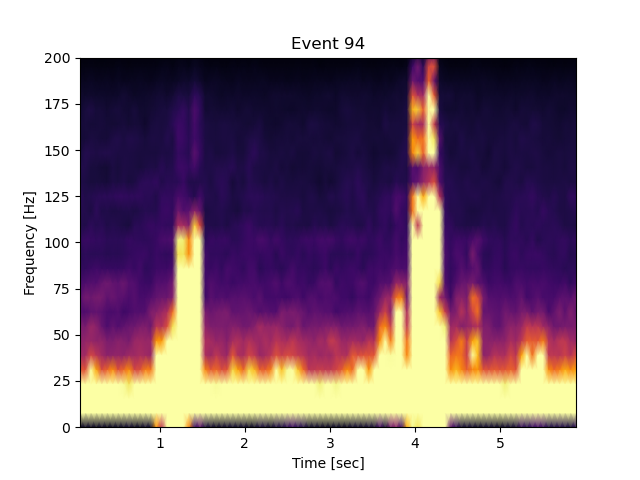

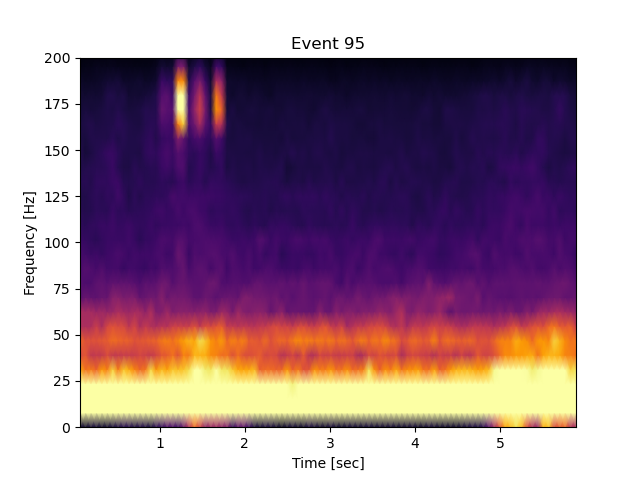

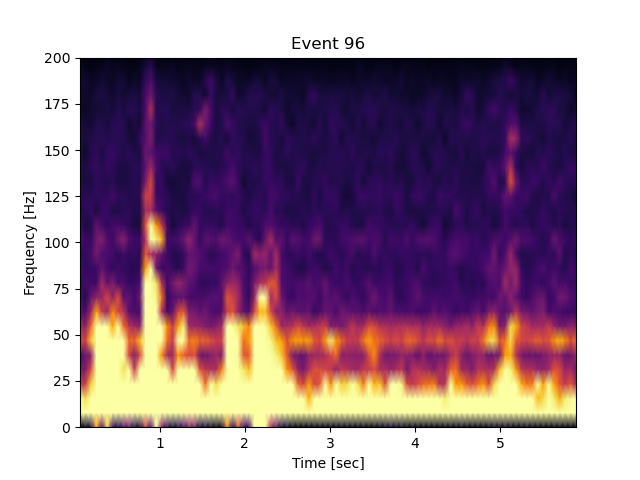

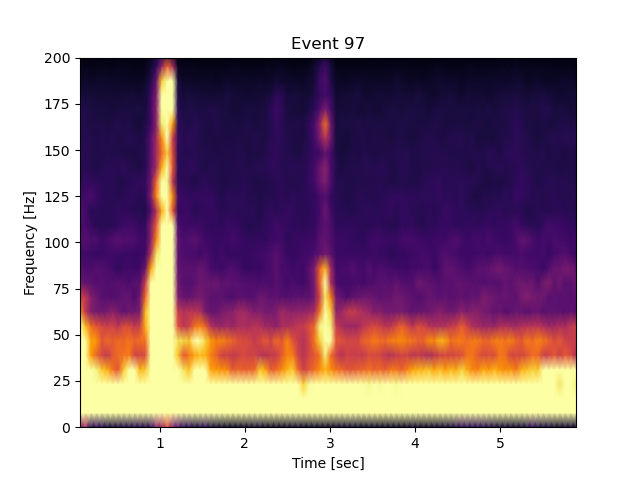

In [334]:
for event_num in range(len(all_picks)):
    if event_num ==0:
        continue
    
    try:
        event_datetime = datetime.datetime.fromtimestamp(np.mean(all_picks['Event '+str(event_num)][1]), tz=datetime.timezone.utc)
        wanted_file_str = 'Eastwind_decimator_2024-12-'+str(event_datetime.day)+'_'+event_datetime.strftime("%H")+"."+event_datetime.strftime("%M")+".00_UTC.h5"

        file = '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/'+wanted_file_str

        f = h5py.File(file)
        attrs = f['Acquisition'].attrs
        data = f['Acquisition']['Raw[0]']['RawData'][:]
        this_time = f['Acquisition']['Raw[0]']['RawDataTime'][:]
        times = sintela_to_datetime(this_time)
        x = np.linspace(0,data.shape[1],data.shape[1]) * attrs['SpatialSamplingInterval']


        fs = attrs['PulseRate'] #sample rate
        bp_top = 200
        bp_bottom = 1
        downsample_rate = int(fs/bp_top)
        #filter by freq
        sos = signal.butter(10, [bp_bottom,bp_top], 'bp', fs=fs, output='sos')
        filtered = signal.sosfiltfilt(sos, data, axis=0)
        #FK filter
        new_format_times = time_fixer_4_fk(times)
        dims = ('time', 'distance')
        patch = dc.Patch(data=filtered, coords=dict(time=[np.datetime64(i) for i in new_format_times], distance=x), dims=dims)
        filt_cutoffs = np.array([0, 400, 8000,np.inf])

        fk_filtered = patch.slope_filter(filt=filt_cutoffs)
        fk_filtered_data = np.array(fk_filtered.data)


        #normalize
        data_normed_filtered = chan_norm(fk_filtered_data)

        times_utc = [i.replace(tzinfo=datetime.timezone.utc) for i in times]
        times_utc_ts = [i.timestamp() for i in times_utc]

        list_of_specs = []

        for pick, chan in zip(all_picks['Event '+str(event_num)][1], all_picks['Event '+str(event_num)][0]):

            slice_loc = int((pick - times_utc_ts[0]) * fs)

            start_event = slice_loc-(int(fs*1))
            end_event = slice_loc+(int(fs*5))

            picked_data = data_normed_filtered[start_event:end_event,chan]
            picked_times = times[start_event:end_event]


            f, t, Sxx = signal.spectrogram(picked_data, fs, nperseg=256,noverlap=128)

            list_of_specs.append(Sxx)


        mean_spec = np.mean(np.array(list_of_specs), axis=0)

        fig,ax = plt.subplots()

        ax.pcolormesh(t, f, mean_spec, shading='gouraud',vmin=0,vmax=0.005, cmap='inferno')
        ax.set_ylabel('Frequency [Hz]')
        ax.set_xlabel('Time [sec]')
        ax.set_ylim([0,200])
        ax.set_title('Event '+str(event_num))
        plt.savefig('../spectrograms/spec_event_'+str(event_num)+'.png',dpi=300)
    except:
        continue

# Debug why the times are off

In [105]:
filt_filled_data, filled_times, new_attrs = preprocessing_step('/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.10.00_UTC.h5')

In [151]:
file_list = sorted(glob('/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024*'))


In [152]:
file_list

['/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.54.17_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.55.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.56.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.57.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.58.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.59.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.00.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.01.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.02.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.03.00_UTC.h5',
 '/1-fnp/petasaur/p-

In [109]:
DAS_channel = DAS(10, filt_filled_data, new_attrs, filled_times)
trigger_on=1
trigger_off=.1

cft = recursive_sta_lta(DAS_channel.data[:,10], int(1 * new_attrs['PulseRate']), int(10 * new_attrs['PulseRate']))
trigger_times = trigger_onset(cft, trigger_on, trigger_off)

In [113]:
filled_times[trigger_times[0][0]]

datetime.datetime(2024, 12, 18, 5, 10, 10, 4)

In [114]:
### Load the picks
with open("../auto_picked_events/auto_picked_events.pkl", "rb") as f:
    picks = pkl.load(f)

In [130]:
all_trigger_times = [[] for holder in range(int(351))]

for i in tqdm(range(len(file_list))):


    if file_list[i][-9:-7] != '00' or i == 0 or current_status == 'Corrupted':

        try:
            filt_filled_data, times, attrs = preprocessing_step(file_list[i])


            current_status = attrs['Status']


        except Exception as e: 
            print(e)
            current_status = 'Corrupted'
            continue

    else:
        first = copy.deepcopy(filt_filled_data)
        times_first = copy.deepcopy(times)
        try:
            filt_filled_data, times, attrs = preprocessing_step(file_list[i])
            current_status = attrs['Status']
        except Exception as e: 
            print(e)
            current_status = 'Corrupted'
            continue
        
        # overlap_data[:,:] = filt_filled_data

        all_data = np.concatenate((first,filt_filled_data), axis=0)
        times_all = np.concatenate((times_first,times), axis=0)


        input_data_dict = {str(i):all_data[:,i] for i in range(all_data.shape[1])}

        new_iterable = [[times_all,dict(attrs),i,input_data_dict[i]] for i in input_data_dict]

        with Pool(48) as p:
            picks = p.map(parallel_event_finding,new_iterable)
        for n,e in enumerate(picks):
            try:
                all_trigger_times[n].extend(e[str(n)][0][:,0])
            except:
                continue

100%|██████████| 5/5 [04:16<00:00, 51.29s/it]


In [142]:
with open("../auto_picked_events_all_chans_fk_filtered.pkl", "rb") as f:
    picks = pkl.load(f)

for n, i in tqdm(enumerate(picks)):
    print(i)

0it [00:00, ?it/s]

351it [00:00, 2698.06it/s]

[datetime.datetime(2024, 12, 18, 4, 54, 34, 150001), datetime.datetime(2024, 12, 18, 4, 55, 16, 412002), datetime.datetime(2024, 12, 18, 5, 13, 16, 28003), datetime.datetime(2024, 12, 18, 5, 13, 16, 9999), datetime.datetime(2024, 12, 18, 5, 19, 11, 382000), datetime.datetime(2024, 12, 18, 5, 31, 6, 744002), datetime.datetime(2024, 12, 18, 6, 9, 30, 588003), datetime.datetime(2024, 12, 18, 6, 9, 30, 586002), datetime.datetime(2024, 12, 18, 6, 45, 11, 420004), datetime.datetime(2024, 12, 18, 7, 26, 59, 629997), datetime.datetime(2024, 12, 18, 7, 26, 59, 629997), datetime.datetime(2024, 12, 18, 23, 7, 23, 644851), datetime.datetime(2024, 12, 18, 23, 8, 11, 412848), datetime.datetime(2024, 12, 18, 23, 13, 47, 31999), datetime.datetime(2024, 12, 18, 23, 13, 47, 31999), datetime.datetime(2024, 12, 18, 23, 14, 24, 34001), datetime.datetime(2024, 12, 18, 23, 14, 34, 979999), datetime.datetime(2024, 12, 18, 23, 14, 23, 982000), datetime.datetime(2024, 12, 18, 23, 14, 34, 979999), datetime.datet

In [136]:
for n,i in tqdm(enumerate(all_trigger_times)):
    print(i)

351it [00:00, 34570.06it/s]

[datetime.datetime(2024, 12, 18, 4, 54, 34, 150001), datetime.datetime(2024, 12, 18, 4, 55, 16, 412002)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 150001), datetime.datetime(2024, 12, 18, 4, 55, 16, 414004)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 150001), datetime.datetime(2024, 12, 18, 4, 55, 16, 429996)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 150001), datetime.datetime(2024, 12, 18, 4, 55, 16, 453996)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 143996), datetime.datetime(2024, 12, 18, 4, 55, 16, 414004)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 142004), datetime.datetime(2024, 12, 18, 4, 55, 16, 403996)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 145997), datetime.datetime(2024, 12, 18, 4, 55, 16, 431998)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 154004), datetime.datetime(2024, 12, 18, 4, 55, 16, 467997)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 178003), datetime.datetime(2024, 12, 18, 4, 55, 16, 591995)]
[datetime.datetime(2024, 12, 18, 4, 54, 34, 195997), da

In [134]:
all_flat_samples = {}
bad_events = {}

event_counter = 0
bad_event_counter = 0
for n,i in tqdm(enumerate(all_trigger_times)):

    ### Get the event ###
    event_num = n
    event_chans, event_times = all_trigger_times['Event '+str(event_num)][0], all_trigger_times['Event '+str(event_num)][1]

    current_chan, current_time = event_chans[0], event_times[0]

    ### Filter out any duplicate picks within the same event ###
    event_chans_no_dupes, event_times_no_dupes = [],[]
    for chan,time in zip(event_chans[1:], event_times[1:]):
        if chan != current_chan and time != current_time:
            event_chans_no_dupes.append(chan)
            event_times_no_dupes.append(time)
        current_chan, current_time = chan,time

    this_pick = [event_chans_no_dupes, event_times_no_dupes]

    ### Make an inital guess on the time offset and velocity ###

    offset_init = np.array(this_pick[1]).min() - 0
    c_init = 2000
    s_x_init, s_y_init, s_z_init = 432000, 1.378e6, -150

    ### initial guesses ###
    num_resets = 32

    init_guesses = np.array([s_x_init, s_y_init, s_z_init, offset_init, c_init])

    initial = init_guesses + np.random.randn(num_resets, len(init_guesses)) * np.array([2e3, 5e3, 1e1, 1e-6, 1e2])

    ### Run the MCMC  on just one for a test ###

    nwalkers, ndim = initial.shape

    sampler = emcee.EnsembleSampler(
        nwalkers, ndim, log_probability,args=[this_pick]
    )
    sampler.run_mcmc(initial, 5000, progress=True);
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)

    ### Check if the inferred wave speed is overr 5000 (this is likely noise) ###
    if np.mean(flat_samples[:,4]) < 5000:

        all_flat_samples['Event '+str(event_counter)] = flat_samples
        event_counter+=1
    else:
        bad_events['Event '+str(bad_event_counter)] = flat_samples
        bad_event_counter += 1 


0it [00:00, ?it/s]


TypeError: list indices must be integers or slices, not str

In [42]:
# Load data #
f = h5py.File('/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.06.00_UTC.h5')
attrs = f['Acquisition'].attrs
data = f['Acquisition']['Raw[0]']['RawData'][:]
this_time = f['Acquisition']['Raw[0]']['RawDataTime'][:]
times = sintela_to_datetime(this_time)
x = np.linspace(0,data.shape[1],data.shape[1]) * attrs['SpatialSamplingInterval']


In [30]:
'/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/*'

'/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/*'

In [47]:
dict(attrs)

{'AcquisitionId': np.bytes_(b'RunName/RunNumber'),
 'BandDataMaxUserValue': np.float64(0.0),
 'BandDataMinUserValue': np.float64(0.0),
 'Build': np.bytes_(b'5.19.6_P'),
 'CommitHash': np.bytes_(b'e0de8303'),
 'DasInstrumentBox': np.bytes_(b'ONYXONYX-0204'),
 'DetectionAccuracy': np.bytes_(b'Not Applicable'),
 'FFID': np.int64(0),
 'FacilityId': np.bytes_(b'WellName2'),
 'FiberID': np.int64(2),
 'GaugeLength': np.float64(6.380952536802641),
 'GaugeLengthUnit': np.bytes_(b'm'),
 'Hostname': np.bytes_(b'ONYX-0204'),
 'MaximumFrequency': np.float64(1000.0),
 'MeasurementStartTime': np.bytes_(b'2024-12-18T05:06:00.000000+00:00'),
 'MinimumFrequency': np.float64(0.0),
 'NumberOfLoci': np.int64(351),
 'OpticalPath': np.bytes_(b'OpticalPath'),
 'PulseRate': np.float64(2000.0),
 'PulseRateUnit': np.bytes_(b'Hz'),
 'PulseWidth': np.float64(20.0),
 'PulseWidthUnit': np.bytes_(b'ns'),
 'SoftwareVersion': np.bytes_(b'7320'),
 'SpatialSamplingInterval': np.float64(6.380952536802641),
 'SpatialSampli

In [88]:
files_list = sorted(glob('/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024*'))


In [89]:
files_list

['/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.54.17_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.55.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.56.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.57.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.58.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_04.59.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.00.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.01.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.02.00_UTC.h5',
 '/1-fnp/petasaur/p-jbod1/antarctica2425/incoming/Eastwind_decimator_2024-12-18_05.03.00_UTC.h5',
 '/1-fnp/petasaur/p-